# Volcan De Fuego: Utilizing Remote Sensing Techniques To Quantify Natural Disaster Recovery and Redevelopment Through Vegetation Regrowth

### Michael Levis, William Skorski, Shannon White 

# Introduction
There are approximately 1,500 potentially active volcanoes on the planet, subject to development and population densities. There are many reasons an estimated 800 million people reside within zones considered hazardous due to their proximity to volcanoes, and why these areas continue to be redeveloped after a major event (BBC News). While relocation of populations may be an impossible alternative due to socioeconomic issues or geographic limitations, these areas can also present opportunities for development and economic activity. Nutrient rich soils surrounding volcanoes offer favorable conditions for farming, and communities may be powered by geothermal energy production. Active volcanoes also draw tourists to the area further improving the local economy.

Therefore, analysis of post-eruption destruction and subsequent recovery is useful in planning for initial development and redevelopment, including the type of development (types of structures, replanting or repurposing as farmland, etc).  Results could be included for risk assessment by government planners for zoning issues as well as allow for informed decisions on what type of structures should be built in areas that are in the predicted path of a volcano. Insurance companies could issue policies with reasonable premiums, whether for a certain term or with provisions excluding damage caused by earthquakes and eruptions. This analysis and visualization will be a useful test case scenario for analyzing other natural disasters in the future, including other eruptions and wildfires. 

# Overview of Event 
Volcan de Fuego is part of the Pacific Ring of Fire and is one of Central America's most active volcanoes. Fuego is also one of three large stratovolcanoes in Guatemala located about 27 miles south-west of Guatemala City and has been erupting on and off since 1531. A previous major eruption was in 1974, but only caused destruction to farmland and left human lives untouched. The recent eruption on June 3rd, 2018 is the center of our study. The eruption caused over $12,000,000 in damages (Reliefweb), resulted in over 100 deaths, and impacted over 1.7 million lives (Worldvision). 

We chose Volcan de Fuego as our study area for the availability of data and satellite images that were accessible. However, as more data becomes available for other locations, the workflow could be reproduced. There are many other situations like Volcan de Fuego within the Pacific Ring of Fire, which contains 452 volcanoes and about 90 percent of the world’s major earthquakes (National Geographic). According to the USGS, on average, 50 to 60 volcanoes erupt every year. This allows for many opportunities for the workflow to be reproduced. Though volcanic eruptions do not make the news headlines as often as other environmental catastrophes, they are not to be overlooked in terms of risk management. 

The importance of our study is not restrained by the geographical bounds that we focused on, but was designed to be expanded and reprojected outward to other volcanic eruptions. Ideally, this study could be more broadly utilized to other natural disasters associated with fire damage, burn scars and vegetation loss. Other natural disasters in mind include the various wildfires that have plagued North America over the last decade.

# Other Work With Volcanoes
Passive and active remote sensing techniques, in addition to GPS and in situ data collection, are used to measure the results of volcanic activity, such as changes to topography and thermal detection (Merucci, et al 2016). The volume of sulfuric acid emitted from volcanoes are measured remotely using a variety of instruments, including the correlation spectrometer (COSPEC, Elias, et al 2006) and the more recent miniature ultraviolet spectrometers (Galle, et al 2002). The  USGS Volcano Hazards Program also has a resource dedicated to tracking volcanoes inside the USA. Recently, satellite imagery has been used to track volcanic ash clouds (Dempsey, 2018), and drone imagery has captured the damage from Kilauea (ABC news). Other reports have also discussed the impacts volcanoes around the world (BBC news). The functions and methods created here to analyze burn and vegetation ratios should complement these other methods.

# Satellite Resolutions and Spectra Ranges
To best observe the effects of the eruption we will be using two different satellites to capture the scope of the eruption as well as zoom in on areas that were particularly damaged. Each satellite will have different resolutions as well as different wavelengths for their spectra. The Landsat 8 satellite has a lower resolution of 30 meters, but has the SWIR band available needed for one of the calculations. The WorldView satellites have a much higher resolution, but not as many bands available to analyze. Below are values for each band used in our analysis. All band values are in nanometers (nm). The near infrared band selected for Worldview was the Near-IR2 band because it more closely matched the Landsat 8 band. The resolutions for all the satellites Digital Globe has data for can be found here:
https://docs.google.com/spreadsheets/d/1S-2JF0uEEodNGU1dYOD8nxlIbS6AvASdkYpiPeZpg5g/edit#gid=0&range=A18

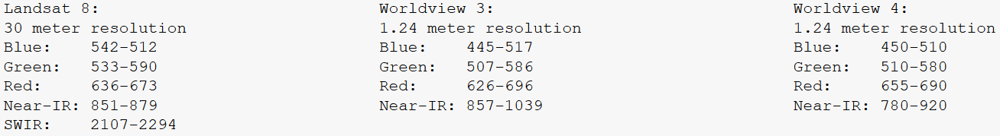

In [1]:
# Importing Image here because it was needed for showing this image
# We did not want to include all the imports here as it was too early in the blog
from PIL import Image
landsat_bands = Image.open("data/group/outputs/figs/landsat_bands.png")
landsat_bands

# Normalized Difference Vegetation Index
The red and near infrared bands are critical for calculating the normalized difference vegetation index (NDVI). NDVI is a vegetation index that can be used to quantify the “greenness” of an area which correlates to healthy vegetation. NDVI is calculated by subtracting the red band from the near infrared band and then dividing that difference by the sum of the two bands. Typically, the NDVI is measured between -1 and 1 where positive values indicate higher amounts of greenness and negative values indicate no vegetation. After the NDVI is calculated for the same location over multiple time periods, the difference can be calculated. This is achieved by taking the post-event NDVI and subtracting the pre-event NDVI (dNDVI). 

The dNDVI can be used to compare vegetation loss from before and after the eruption, or between two scenes post eruption to look at possible vegetation regrowth. When comparing scenes before and after the eruption, we expect to see more negative values associated with the lava flow. When comparing two post events we expect to see some positive values associated with vegetation regrowth.

# Normalized Burn Ratio
Another useful measure for observing the impacts of an eruption or other natural disaster is the normalized burn ratio (NBR). NBR is used to measure the severity of a fire as well as its extent. It is calculated by taking the difference between the near infrared and shortwave bands and dividing by the sum of the near infrared and shortwave bands. Comparing the NBRs from a pre and post event can be used to observe the level of burn severity of your area of interest. This difference is called the difference normalized burn ratio (dNBR). 

The dNBR is calculated by taking the pre-event NBR and subtracting the post-event NBR. We assigned four classifications to distinguish the level of burn severity. Areas that experienced enhanced regrowth will be displayed in green and areas that experienced a high amount of burn will be displayed in a dark red with varying levels of intensity in between.

In this blog, we will show the dNDVI and dNBR over the entire area of interest using Landsat 8 data. This will be supplemented by zoomed in plots of dNDVI at two locations that were badly affected by the eruption using Digital Globe’s Worldview 3 and 4 satellites. 

# Functions
Below are functions that we use to minimize the amount of code present in the blog. They are also used to help expedite repetitive processing and plotting while still allowing for user input. Expressive names were used so viewers can quickly read the code and understand what the code is doing. Each plotting function has a save figure option commented out. If you want to save any figures, add “bool=True” to the end of the plotting code of interest. All code was written using PEP8 styling for clean and consistent code.


In [1]:
# Importing libraries
import numpy as np
from glob import glob
import os

import numpy.ma as ma
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

import rasterio as rio
from rasterio.plot import plotting_extent
from rasterio.mask import mask
from rasterio import Affine
from rasterio.warp import reproject, Resampling

import geopandas as gpd
from shapely.geometry import mapping, box
from shapely.geometry import Polygon, Point
import folium
from folium import plugins

import earthpy as et
import earthpy.spatial as es

import warnings
warnings.filterwarnings("ignore")

sns.set_style('white')

os.chdir(os.path.join(et.io.HOME, 'earth-analytics'))

In [3]:
def plot_rgb_cir_l8(image, date, bool=False):
    """ Creates a mapping function for plotting rgb and cir images from Landsat 8

    Parameters
    ----------
    image : raster
        Name of the file you want to plot

    date : string
        Date of image

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_rgb_cir_l8(landsat_pre, "03-02-2017")
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    sns.set(font_scale=1.5)

    es.plot_rgb(image, rgb=[3, 2, 1],
                ax=ax1,
                stretch=True)
    ax1.set(title="Landsat 8 | 30 meter resolution \n"
            + "RGB Image " + date)

    es.plot_rgb(image, rgb=[4, 3, 2],
                ax=ax2,
                stretch=True)
    ax2.set(title="Landsat 8 | 30 meter resolution \n"
            + "CIR Image " + date)
    plt.show()
    if bool == True:
        fig.savefig("data/group/outputs/figs/landsat_rgb_cir_" + date + ".png")

In [4]:
def remove_clouds(array, qa_array, masked_values):
    """ Removes the clouds and cloud shadows from Landsat data
        The output values are a new array with clouds removed for more accurate calculations.

    Parameters
    ----------
    array : a 3-dimensional array of Landsat values that need to have clouds and cloud shadows removed
        The shape of array should be (i, j, k)

    qa_array : a 3-dimensional quality assurance array from Landsat QA file
        The last two dimensions of this array should match the last two dimensions of the input array
        The shape of qa_array should be (1, j, k)

    masked_values : list of the mask values to be used to mask the array

    Returns
    -------
    array_cloud_masked : array of same shape as the input array, with the cloud and cloud shadows masked

    Example
    -------
    landsat_pre_cl = remove_clouds(landsat_pre, landsat_pre_qa, masked_values)
    """
    cl_mask = np.zeros(qa_array.shape)

    for cval in masked_values:
        cl_mask[qa_array == cval] = 1

    cloud_mask = np.broadcast_to(cl_mask == 1, array.shape)
    array_cloud_masked = ma.masked_array(array,
                                         mask=cloud_mask)

    return(array_cloud_masked)

In [5]:
def calc_dndvi_dnbr_l8(pre_image, post_image):
    """ Creates a function for calculating the dNDVI and dNBR for Landsat 8

    Parameters
    ----------
    pre_image : raster
        Name of the pre image raster

    post_iamge : raster
        Name of the post image raster

    Returns
    ------
    dndvi : array of calculated dndvi values for the image
    dnbr : array of calculated dnbr values for the image

    Example
    -------
    landsat_dndvi_06, landsat_dnbr_06 = calc_dndvi_dnbr_l8(landsat_pre_masked, landsat_post_06_masked)
    """
    pre_ndvi = (pre_image[4] - pre_image[3]) / (pre_image[4] + pre_image[3])
    post_ndvi = (post_image[4] - post_image[3]) / \
        (post_image[4] + post_image[3])

    dndvi = post_ndvi - pre_ndvi

    pre_nbr = (pre_image[4] - pre_image[6]) / (pre_image[4] + pre_image[6])
    post_nbr = (post_image[4] - post_image[6]) / \
        (post_image[4] + post_image[6])

    dnbr = pre_nbr - post_nbr

    return dndvi, dnbr

In [6]:
def plot_dndvi_l8(dndvi1, date1, dndvi2, date2, bool=None):
    """ Creates function for plotting dNDVI images from Landsat 8

    Parameters
    ----------
    dndvi1 : raster
        Name of the first dndvi raster you want to plot

    date1 : string
        Date associated with the first plotted dNDVI data

    dndvi2 : raster
        Name of the second dndvi raster you want to plot

    date2 : string
        Date associated with the second plotted dNDVI data

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_dndvi_l8(landsat_dndvi_06, "06-25-2018 - 03-02-2017",
             landsat_dndvi_11, "11-16-2018 - 03-02-2017")
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    sns.set(font_scale=1.5)

    dndvi1 = ax1.imshow(dndvi1, cmap='PiYG',
                        vmin=-1, vmax=1)
    ax1.set(title="Landsat 8 Derived dNDVI" + "\n" + date1)
    ax1.axis('off')

    dndvi2 = ax2.imshow(dndvi2, cmap='PiYG',
                        vmin=-1, vmax=1)
    ax2.set(title="Landsat 8 Derived dNDVI" + "\n" + date2)
    ax2.axis('off')

    fig.colorbar(dndvi1, fraction=.0168, ax=(ax1, ax2))
    plt.show()
    if bool is not None:
        fig.savefig("data/group/outputs/figs/landsat_dNDVI_" +
                    date1 + "_" + date2 + ".png")

In [7]:
def plot_hist_dndvi_l8(dndvi1, date1, dndvi2, date2, bool=None):
    """ Creates a mapping function for plotting dNDVI histograms for Landsat 8

    Parameters
    ----------
    dndvi1 : raster
        Name of the first dndvi raster you want to plot

    date1 : string
        Date associated with the first plotted dNDVI data

    dndvi2 : raster
        Name of the second dndvi raster you want to plot

    date2 : string
        Date associated with the second plotted dNDVI data

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_hist_dndvi_l8(landsat_dndvi_11, "March 2nd, 2017 and Novemeber 16th, 2018", 
                landsat_dndvi_06, "March 2nd, 2017 and June 25th, 2018")
    """
    fig,  (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    sns.set(font_scale=1.0)

    ax1.hist(dndvi1.ravel(), bins=[-.99, -.5, -.2,
                                   0, .2, .5, 1], color="purple")
    ax1.set(title="Landsat 8 Derived dNDVI Histogram \n" + date1)

    ax2.hist(dndvi2.ravel(), bins=[-.99, -.5, -.2,
                                   0, .2, .5, 1], color="purple")
    ax2.set(title="Landsat 8 Derived dNDVI Histogram \n" + date2)

    if bool is not None:
        fig.savefig("data/group/outputs/figs/landsat_hist_dNDVI_" +
                    date1 + date2 + ".png")

In [8]:
def plot_dnbr_l8(dnbr1, date1, dnbr2, date2, bool=None):
    """ Creates function for plotting dNDVI images from Landsat 8

    Parameters
    ----------
    dnbr1 : raster
        Name of the first dndvi raster you want to plot

    date1 : string
        Date associated with the first plotted dNBR data

    dnbr2 : raster
        Name of the second dndvi raster you want to plot

    date2 : string
        Date associated with the second plotted dNBR data

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_dnbr_l8(landsat_dnbr_06, "06-25-2018 - 03-02-2017",
             landsat_dnbr_11, "11-16-2018 - 03-02-2017")
    """
    dnbr_class1 = np.digitize(dnbr1, class_bins)
    dnbr_class1_ma = np.ma.masked_array(dnbr_class1, dnbr1.mask)

    dnbr_class2 = np.digitize(dnbr2, class_bins)
    dnbr_class2_ma = np.ma.masked_array(dnbr_class2, dnbr2.mask)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    sns.set(font_scale=1.5)

    dnbr1 = ax1.imshow(dnbr_class1_ma, cmap=dnbr_cmap)
    values1 = np.unique(dnbr_class1_ma.ravel())
    es.draw_legend(dnbr1,
                   classes=values1,
                   titles=class_dnbr)
    ax1.set(title="Landsat 8 Derived dNBR" + "\n" + date1)
    ax1.axis('off')

    dnbr2 = ax2.imshow(dnbr_class2_ma, cmap=dnbr_cmap)
    values2 = np.unique(dnbr_class2_ma.ravel())
    es.draw_legend(dnbr2,
                   classes=values2,
                   titles=class_dnbr)
    ax2.set(title="Landsat 8 Derived dNBR" + "\n" + date2)
    ax2.axis('off')
    plt.tight_layout()
    plt.show()
    if bool is not None:
        fig.savefig("data/group/outputs/figs/landsat_dNBR_" +
                    date1 + "_" + date2 + ".png")

In [9]:
def plot_hist_dnbr_l8(dnbr1, date1, dnbr2, date2, bool=None):
    """ Creates a mapping function for plotting dNBR histograms for Landsat 8

    Parameters
    ----------
    dnbr1 : raster
        Name of the first dndvi raster you want to plot

    date1 : string
        Date associated with the first plotted dNBR data

    dnbr2 : raster
        Name of the second dndvi raster you want to plot

    date2 : string
        Date associated with the second plotted dNBR data

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_hist_dnbr_l8(landsat_dnbr_11, "March 2nd, 2017 and Novemeber 16th, 2018", 
                landsat_dnbr_06, "March 2nd, 2017 and June 25th, 2018")
    """
    fig,  (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    sns.set(font_scale=1.0)

    ax1.hist(dnbr1.ravel(), bins=[-.99, -.5, -.2,
                                  0, .2, .5, 1], color="purple")
    ax1.set(title="Landsat 8 Derived dNBR Histogram \n" + date1)

    ax2.hist(dnbr2.ravel(), bins=[-.99, -.5, -.2,
                                  0, .2, .5, 1], color="purple")
    ax2.set(title="Landsat 8 Derived dNBR Histogram \n" + date2)

    if bool is not None:
        fig.savefig("data/group/outputs/figs/landsat_hist_dNBR_" +
                    date1 + date2 + ".png")

In [10]:
def get_bands_wv(location, date):
    """ Collects the bands for a given date for Worldview 3 and 4

    Parameters
    ----------
    date : string
        String used to subset by date

    location : string
        String used to subset by location

    Returns
    -------
    bands : globbed bands for a given data for Worldview 3 and 4

    Example
    -------
    rodeo_06 = get_bands_wv("rodeo", "06_06")
    """
    bands = glob("data/group/digital-globe/" +
                 location + "/" + date + "/*.tif")
    bands.sort()
    return bands

In [11]:
def crop_res(arr, source, shape1, shape2, aff_shape, aff1):
    """ Crops and resamples Worldview 3 and 4 data to the same shape

    Parameters
    ----------
    arr : raster
        Name of the cropped raster that will be resampled

    source : rasterio source object
        Name of the rasterio source object used to create arr

    shape1 : integer
        Value used to create the proper resolution for the first value
        printed from .shape

    shape2 : integer
        Value used to create the proper resolution for the second value
        printed from .shape

    aff_shape : integer
        Value used to create the proper resolution in the affine shape

    aff1 : affine
        Name of the cropped affine object associated with both arr and source

    Returns
    -------
    newarr : new array that has been cropped and resampled

    Example
    -------
    golf_post_06 = crop_res(golf_post_06, golf_06, 1.001, 1.001, 1.001, golf_06_affine)
    """
    arr = arr
    newarr = np.empty(shape=(arr.shape[0],
                             round(arr.shape[1] / (shape1)),
                             round(arr.shape[2] / (shape2))))

    aff = aff1
    newaff = rio.Affine(aff.a * (aff_shape), aff.b, aff.c,
                        aff.d, aff.e * (aff_shape), aff.f)

    reproject(
        arr, newarr,
        src_transform=aff,
        dst_transform=newaff,
        src_crs=source.crs,
        dst_crs=source.crs,
        resampling=Resampling.bilinear)

    return newarr

In [12]:
def plot_rgb_cir_wv(image, num, location, date, bool=None):
    """ Creates a mapping function for plotting rgb images for Worldview 3 and 4

    Parameters
    ----------
    image : raster
        Name of the file you want to plot

    num : string
        Either 3 or 4 to indicate satellite source

    location : string
        Location of image

    date : string
        Date of image

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_rgb_cir_wv(rodeo_post_22, "3", "El Rodeo", "June 22nd, 2018")
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    sns.set(font_scale=1.5)

    es.plot_rgb(image, rgb=[2, 1, 0],
                ax=ax1,
                stretch=True)
    ax1.set(title="Worldview " + num + " | 1.24 meter resolution \n"
            + "RGB Image | " + location + " " + date)

    es.plot_rgb(image, rgb=[3, 2, 1],
                ax=ax2,
                stretch=True)
    ax2.set(title="Worldview " + num + " | 1.24 meter resolution \n"
            + "CIR Image | " + location + " " + date)
    plt.show()
    if bool is not None:
        fig.savefig("data/group/outputs/figs/digitalglobe_rgb_cir" +
                    location + "_" + date + ".png")

In [13]:
def calc_dndvi_wv(pre_image, post_image):
    """ Creates a function for calculating the dNDVI for Worldview 3 and 4

    Parameters
    ----------
    pre_image : raster
        Name of the pre event image

    post_image : raster
        Name of the post event image

    Returns
    -------
    dndvi : calculated dndvi raster of the dates of interest

    Example
    -------
    dndvi_golf_22 = calc_dndvi_wv(golf_pre, golf_post_22)
    """
    pre_ndvi = (pre_image[3] - pre_image[2]) / (pre_image[3] + pre_image[2])
    post_ndvi = (post_image[3] - post_image[2]) / \
        (post_image[3] + post_image[2])

    dndvi = post_ndvi - pre_ndvi
    return dndvi

In [14]:
def plot_dndvi_wv(location, dndvi1, date1, dndvi2, date2, bool=None):
    """ Creates function for plotting dNDVI images from Worldview 3 and 4

    Parameters
    ----------
    location : string
        Name of the location associated with the data

    dndvi1 : raster
        Name of the first dndvi raster you want to plot

    date1 : string
        Date associated with the first plotted dNDVI data

    dndvi2 : raster
        Name of the second dndvi raster you want to plot

    date2 : string
        Date associated with the second plotted dNDVI data

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_dndvi_wv("El Rodeo", dndvi_rodeo_06, "06-06-2018 - 02-01-2017",
             dndvi_rodeo_23, "06-23-2018 - 02-01-2017")
    """
    if location == "Golf Course":
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    elif location == "El Rodeo":
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 16))
    sns.set(font_scale=1.5)

    dndvi1 = ax1.imshow(dndvi1, cmap='PiYG',
                        vmin=-1, vmax=1)
    ax1.set(title="Worldview Derived dNDVI, " + location + "\n" + date1)
    ax1.axis('off')

    dndvi2 = ax2.imshow(dndvi2, cmap='PiYG',
                        vmin=-1, vmax=1)
    ax2.set(title="Worldview Derived dNDVI, " + location + "\n" + date2)
    ax2.axis('off')

    if location == "Golf Course":
        fig.colorbar(dndvi1, fraction=.015, ax=(ax1, ax2))

    elif location == "El Rodeo":
        fig.colorbar(dndvi1, fraction=.025, ax=(ax1, ax2))

    plt.show()
    if bool is not None:
        fig.savefig("data/group/outputs/figs/digitalglobe_dNDVI_" +
                    location + "_" + date1 + "_" + date2 + ".png")

In [15]:
def plot_hist_dndvi_wv(location, dndvi1, date1, dndvi2, date2, bool=None):
    """ Creates a mapping function for plotting dNDVI histograms for Worldview 3 and 4

    Parameters
    ----------
    dndvi1 : raster
        Name of the first dndvi raster you want to plot

    date1 : string
        Date associated with the first plotted dNDVI data

    dndvi2 : raster
        Name of the second dndvi raster you want to plot

    date2 : string
        Date associated with the second plotted dNDVI data

    bool : boolean
        boolean to indicate if you want to save the output figure

    Example
    -------
    plot_hist_dndvi_wv("El Rodeo", dndvi_rodeo_06, "February 1st, 2017 and June 6th, 2018",
                        dndvi_rodeo_22, "February 1st, and June 22nd, 2018")
    """
    fig,  (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    sns.set(font_scale=1.0)

    ax1.hist(dndvi1.ravel(),
             bins=[-.99, -.7, -.5, -.2, 0, .2, .5, .7, 1], color="purple")
    ax1.set(title="Worldview Derived dNDVI Histogram \n"
            + location + " " + date1)

    ax2.hist(dndvi2.ravel(),
             bins=[-.99, -.7, -.5, -.2, 0, .2, .5, .7, 1], color="purple")
    ax2.set(title="Worldview Derived dNDVI Histogram \n"
            + location + " " + date2)

    plt.show()
    if bool is not None:
        fig.savefig("data/group/outputs/figs/digitalglobe_hist_dNDVI_" +
                    location + "_" + date1 + "_" + date2 + ".png")

In [16]:
# Constants
# Generate array of all possible cloud / shadow values
cloud_shadow = [328, 392, 840, 904, 1350]
cloud = [352, 368, 416, 432, 480, 864, 880, 928, 944, 992]
high_confidence_cloud = [480, 992]
masked_values = cloud_shadow + cloud + high_confidence_cloud

# Define Landsat extent
extent_geojson = {'type': 'Polygon',
                  'coordinates': (((720000, 1605000),
                                   (736500, 1605000),
                                   (736500, 1592000),
                                   (720000, 1592000),
                                   (720000, 1605000)),)}

# Defining dNBR color bins
class_bins = [-np.inf, .1, .27, .66, np.inf]

class_dnbr = ["Unburned",
              "Low Severity",
              "Moderate Severity",
              "High Severity"]

dnbr_colors = ["g", "yellowgreen", "coral", "maroon"]
dnbr_cmap = ListedColormap(dnbr_colors)

# Location
This blog will focus in on Guatemala, specifically around Volcan De Fuego, and the surrounding Hotel La Reunion Golf Course and a neighborhood located in the town of El Rodeo. Global maps were created using a shapefile from naturalearthdata.com. Regional maps and markers were created using the folium library and were used to indicate our two locations of interest, the Hotel La Reunion, and the town of El Rodeo.

In [17]:
# Import world boundary shapefile
worldBound = gpd.read_file("data/group/shapefile/ne_110m_land.shp")
# Add location point for study area
loc_df = np.array([[-90.880635, 14.474690]])
geometry = [Point(xy) for xy in loc_df]
loc = gpd.GeoDataFrame(geometry, columns=["geometry"], crs={
                       'init': 'epsg:4326'})

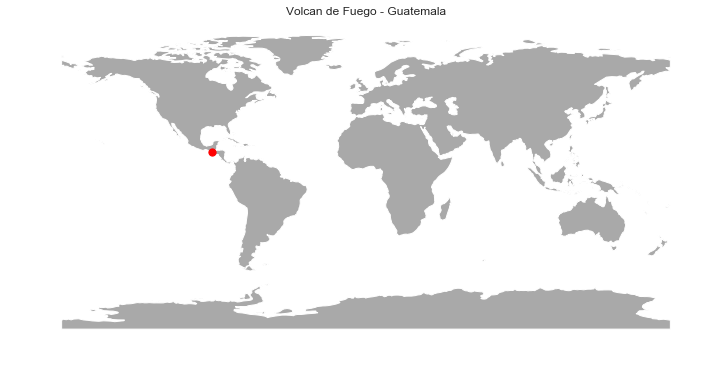

In [18]:
# Plot worldBound data
fig, ax = plt.subplots(figsize=(12, 10))
worldBound.plot(color='darkgrey',
                ax=ax)
ax.set(title="Volcan de Fuego - Guatemala")
# Add location point
loc.plot(ax=ax,
         markersize=52,
         color='red')
ax.set_axis_off()
plt.show()

Here is a closeup mapview of the volcano.

In [19]:
loc_map = folium.Map(location=[14.474690, -90.880635], tiles='Stamen Terrain')
folium.Marker(
    location=[14.474690, -90.880635],
    popup='Volcan de Fuego',
    icon=folium.Icon()).add_to(loc_map)
loc_map

Zooming in even further are the two locaitons we will focus on later in the blog using Digital Globe's high resolution data. The red circle is the hotel and golf course and the blue circle is the small village of El Rodeo. Both locations were heavily impacted by the lava flow.

In [20]:
dg_map = folium.Map(location=[14.4251705735, -90.82545023],
                    zoom_start=13, tiles="Stamen Terrain")
folium.CircleMarker([14.4251705735, -90.82545023], radius=30,
                    popup="Hotel La Reunion and Golf Course", color="red").add_to(dg_map)
folium.CircleMarker([14.401751, -90.818018], radius=30,
                    popup="El Rodeo", color='blue').add_to(dg_map)
dg_map

# Landsat Pre Eruption - March 2, 2017

In [21]:
# Collect all landsat pre bands - March 02 2017
all_landsat_pre_bands = glob(
    "data/group/landsat/pre/LC08_L1TP_020050_20170302_20170316_01_T1_sr_*band*.tif")
all_landsat_pre_bands.sort()

# Stack rasters
landsat_pre_path = "data/group/outputs/landsat_pre.tif"
es.stack_raster_tifs(all_landsat_pre_bands,
                     landsat_pre_path)

with rio.open(landsat_pre_path) as landsatpre:
    landsat_pre, landsat_pre_affine = mask(
        landsatpre, [extent_geojson], crop=True)

# Open the pixel_qa layer for Landsat pre scene
with rio.open("data/group/landsat/pre/LC08_L1TP_020050_20170302_20170316_01_T1_pixel_qa.tif") as landsat_pre_cl:
    landsat_pre_qa, landsat_pre_qa_affine = mask(
        landsat_pre_cl, [extent_geojson], crop=True)

landsat_pre_masked = remove_clouds(landsat_pre, landsat_pre_qa, masked_values)

The pre-eruption Landsat 8 data from March 2nd, 2017 is displayed as a true color RBG image and a color infrared (CIR) image, both with 30 meter spatial resolution. The golf course and town of El Rodeo are pictured in the southeast corner. The RGB and CIR images are used to visualize the destruction. CIR images help differentiate between vegetation and fire scars. The red indicates areas of high vegetation and the green indicates areas of low vegetation or fire scars. These images help us visualize the baseline environment for the volcano prior to the eruption. All RGB and CIR images for Landsat 8 show untouched data. However, the dNDVI and dNBR plots use cloudmasked data to reduce errors associated with clouds and shadows.

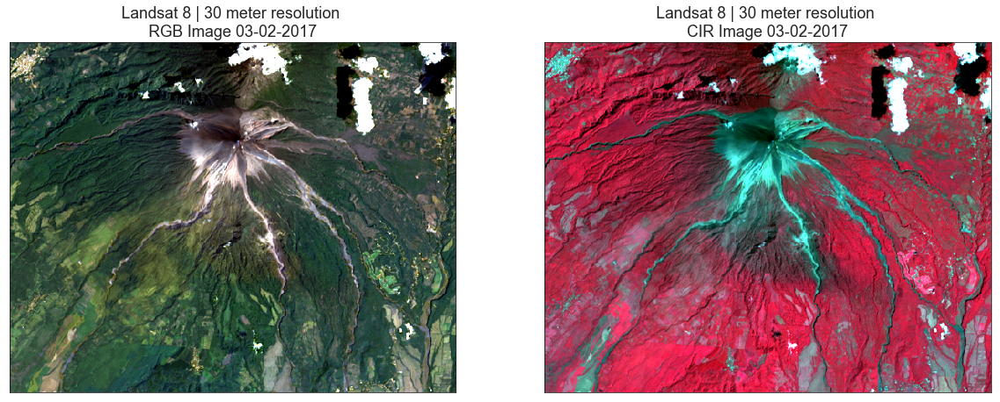

In [22]:
plot_rgb_cir_l8(landsat_pre, "03-02-2017")

# Landsat Post Eruption - June 25, 2018

In [23]:
# Collect all landsat post bands - June 25 2018
all_landsat_post_06_bands = glob(
    "data/group/landsat/post/LC08_L1TP_020050_20180625_20180704_01_T1_sr_*band*.tif")
all_landsat_post_06_bands.sort()

# Stack rasters
landsat_post_06_path = "data/group/outputs/landsat_post_06.tif"
es.stack_raster_tifs(all_landsat_post_06_bands,
                     landsat_post_06_path)

with rio.open(landsat_post_06_path) as landsatpost06:
    landsat_post_06, landsat_post_06_affine = mask(
        landsatpost06, [extent_geojson], crop=True)

# Open the pixel_qa layer for Landsat post scene
with rio.open("data/group/landsat/post/LC08_L1TP_020050_20180625_20180704_01_T1_pixel_qa.tif") as landsat_post_06_cl:
    landsat_post_06_qa, landsat_post_06_qa_affine = mask(
        landsat_post_06_cl, [extent_geojson], crop=True)

landsat_post_06_masked = remove_clouds(
    landsat_post_06, landsat_post_06_qa, masked_values)

Comparing the pre eruption CIR image with the post eruption CIR image taken only 20 days after highlights the extent of the lava flow. The large swath of lava flowing down to the southeast will be our area of study later in this blog post. The white rectangles in the southeast corner are warehouses that were spared from the eruptions destruction.

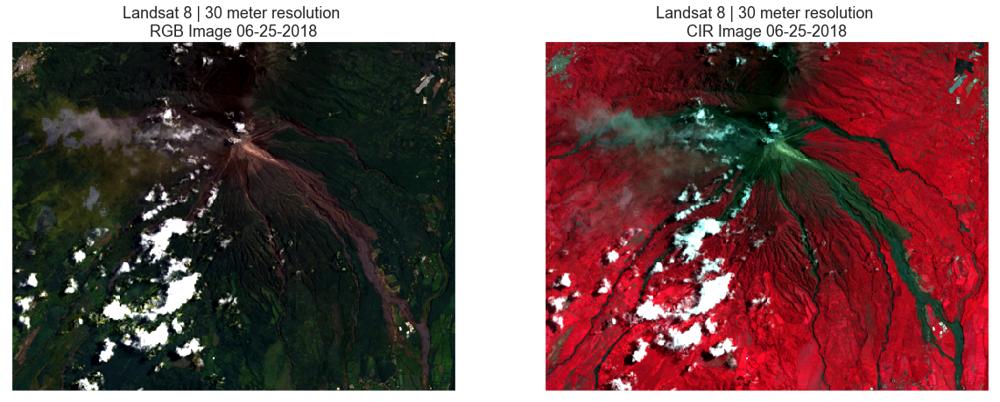

In [24]:
plot_rgb_cir_l8(landsat_post_06, "06-25-2018")

# Landsat Post Eruption - November 16, 2018

In [25]:
# Collect all landsat post2 bands - November 16 2018
all_landsat_post_11_bands = glob(
    "data/group/landsat/post/LC08_L1TP_020050_20181116_20181129_01_T1_sr_*band*.tif")
all_landsat_post_11_bands.sort()

# Stack rasters
landsat_post_11_path = "data/group/outputs/landsat_post11.tif"
es.stack_raster_tifs(all_landsat_post_11_bands,
                     landsat_post_11_path)

with rio.open(landsat_post_11_path) as landsatpost11:
    landsat_post_11, landsat_post_11_affine = mask(
        landsatpost11, [extent_geojson], crop=True)

# Open the pixel_qa layer for Landsat post2 scene
with rio.open("data/group/landsat/post/LC08_L1TP_020050_20181116_20181129_01_T1_pixel_qa.tif") as landsat_post_11_cl:
    landsat_post_11_qa, landsat_post_11_qa_affine = mask(
        landsat_post_11_cl, [extent_geojson], crop=True)

landsat_post_11_masked = remove_clouds(
    landsat_post_11, landsat_post_11_qa, masked_values)

The RGB and CIR images from 5 months after the eruption show mild recovery.

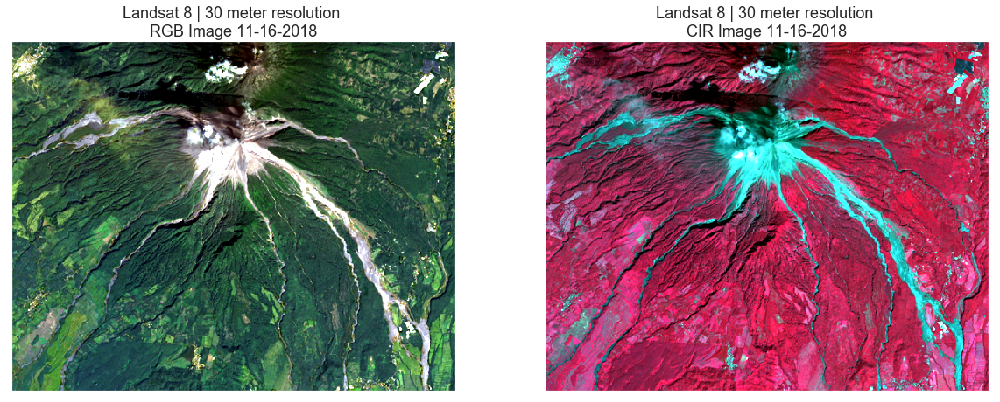

In [26]:
plot_rgb_cir_l8(landsat_post_11, "11-16-2018")

# dNDVI and dNBR 
## Between March 02, 2017 and June 25, 2018 and March 02, 2017 and November 16, 2018

The dNDVI between March 2nd, 2017 and June 25th, 2018 highlight the areas that were heavily affected by the lava flow in pink. We can see the large swath of lava in the southeast has the darkest pink indicating a large loss of vegetation.

As expected, the dNDVI between November 16th, 2018, and March 2nd, 2017 is more muted than June 25th. There are still large negative values associated with the hardened lava flow. However, there has been an increase in vegetation on the south slope of the volcano which was relatively unaffected by the eruption.

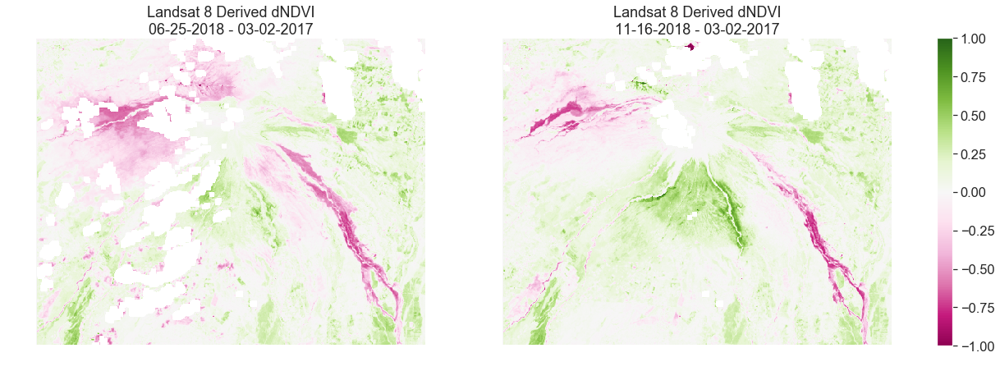

In [27]:
landsat_dndvi_06, landsat_dnbr_06 = calc_dndvi_dnbr_l8(
    landsat_pre_masked, landsat_post_06_masked)
landsat_dndvi_11, landsat_dnbr_11 = calc_dndvi_dnbr_l8(
    landsat_pre_masked, landsat_post_11_masked)
plot_dndvi_l8(landsat_dndvi_06, "06-25-2018 - 03-02-2017",
              landsat_dndvi_11, "11-16-2018 - 03-02-2017")

dNDVI Histograms can also highlight the changes in vegetation. Here we see the dNDVI is middiling. Looking at the March 2nd, 2017 rgb and cir images we would have expected fairly high NDVI values. Values close to zero indicate similar values between the pre and post NDVIs. The large negative excursions associated with the post event is seen in the high amounts of negative values. Comparing the two histograms, we see an increase in values around 0-0.25 indicating mild vegetation regrowth.

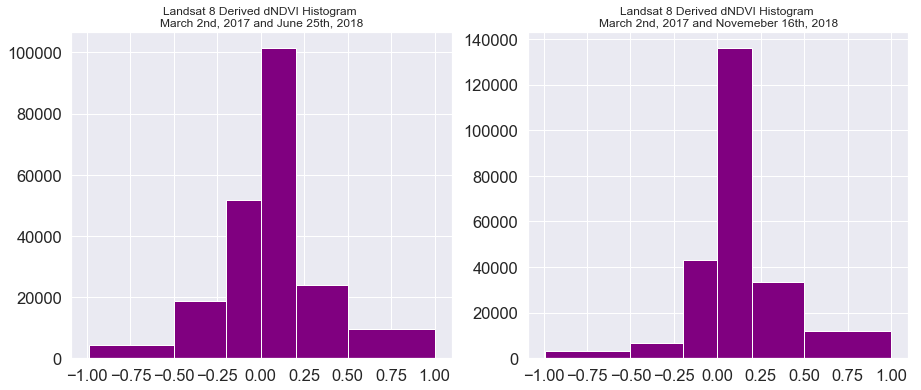

In [28]:
plot_hist_dndvi_l8(landsat_dndvi_06, "March 2nd, 2017 and June 25th, 2018",
                   landsat_dndvi_11, "March 2nd, 2017 and Novemeber 16th, 2018")

June 25, 2018 post NBR is subtracted from March 2, 2017 pre NBR to show the severity of the burn areas using an index of -1 to 1. The dNBR does a great job of highlighting the lava scars as well. We can once again see the highest severity areas are associated with the large swath of lava in the south east. We will zoom in on this area a little later.

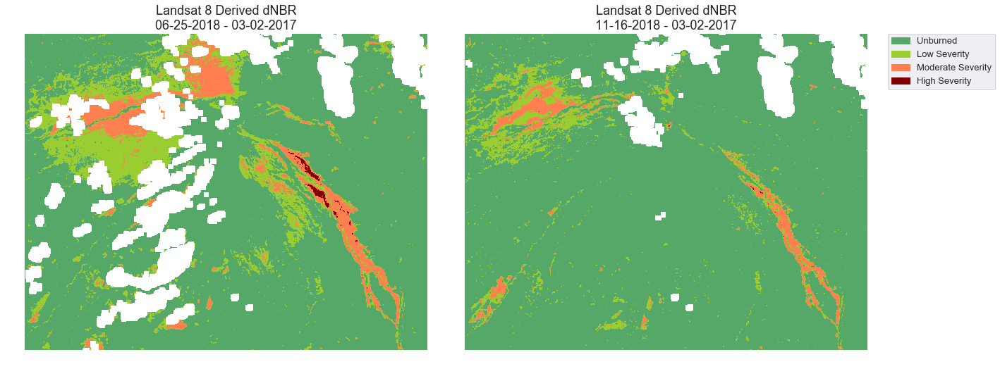

In [29]:
plot_dnbr_l8(landsat_dnbr_06, "06-25-2018 - 03-02-2017",
             landsat_dnbr_11, "11-16-2018 - 03-02-2017")

The dNBR Histogram shows a similar story to the dNDVI histogram. In this case, the positive values indicate high severity so the overall trend is reversed.

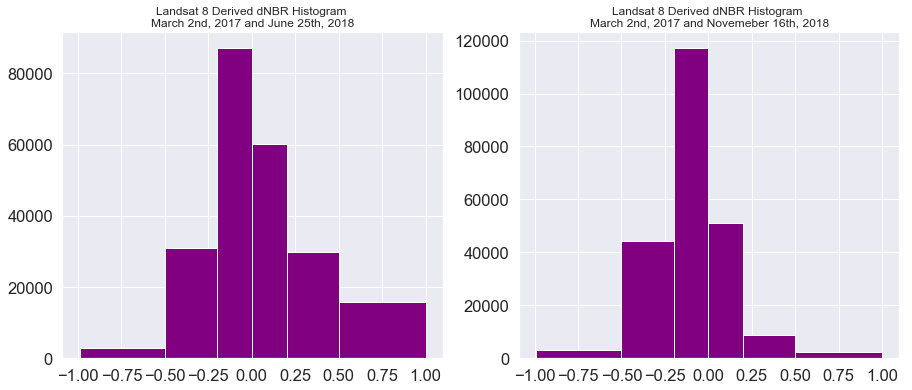

In [30]:
plot_hist_dnbr_l8(landsat_dnbr_06, "March 2nd, 2017 and June 25th, 2018",
                  landsat_dnbr_11, "March 2nd, 2017 and Novemeber 16th, 2018")

# Comparing dNDVI for both post scenes compared to June 25, 2018

Looking at the dNDVI plot comparing both post scenes (left) we can see some mild vegetation growth indicated in the green. The white areas indicate no change in vegetation in those areas between the two post scenes. Comparing that to the June 25th, 2018 dNDVI (right) we can see where the main lava flows were, and see that some of the vegetation increases in the post-post image border the lava flow edge.

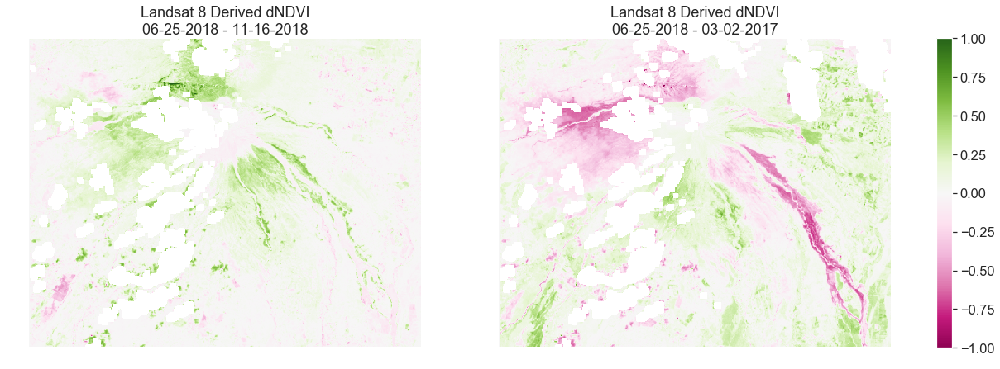

In [31]:
landsat_dndvi_post, landsat_dnbr_post = calc_dndvi_dnbr_l8(
    landsat_post_06_masked, landsat_post_11_masked)
plot_dndvi_l8(landsat_dndvi_post, "06-25-2018 - 11-16-2018",
              landsat_dndvi_06, "06-25-2018 - 03-02-2017")

Once again, comparing the dNDVI values between two post scenes (left) and the June scene immediately after the eruption (right) we can see an increase in higher ndvi values 5 months after the eruption relative to immediately after the eruption.

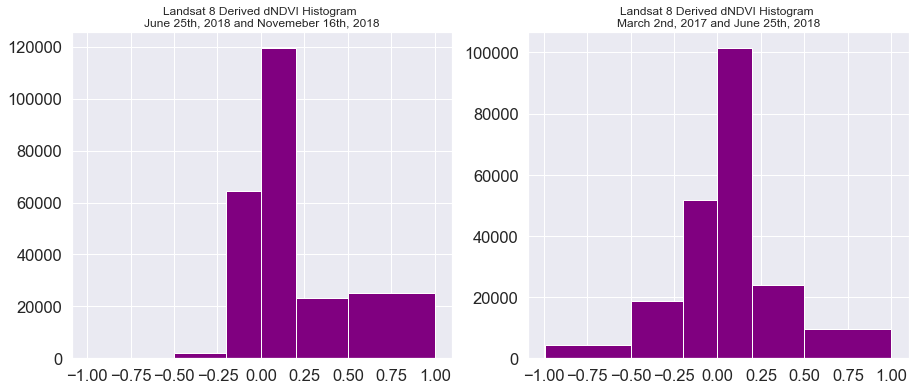

In [32]:
plot_hist_dndvi_l8(landsat_dndvi_post, "June 25th, 2018 and Novemeber 16th, 2018",
                   landsat_dndvi_06, "March 2nd, 2017 and June 25th, 2018")

# Digital Globe Data

Now we will zoom in and explore two sites that were badly hit by the eruption just southeast of the volcano using high resolution imagery (1.3 meters). The two locations are a golf course and hotel and a small town called El Rodeo. The high resolution data is from Digital Globe's Worldview 3 and Worldview 4 satellites.

# Worldview 3 Pre Eruption - Golf Course - February 1, 2017

In [33]:
# Pre-eruption data - 02/01/2017
golf_pre = get_bands_wv("golf", "02_01_2017")
golf_pre_path = "data/group/digital-globe/outputs/golf_pre"
es.stack_raster_tifs(golf_pre, golf_pre_path)
with rio.open(golf_pre_path) as golfpre:
    golf_pre_plot = golfpre.read(masked=True)
    golf_extent = mapping(box(*golfpre.bounds))

This pre-eruption image shows the pristine condition the golf course was in before being enveloped in lava. Unfortunately, the only date prior to the eruption that has usable data for this location was February 1st, 2017.

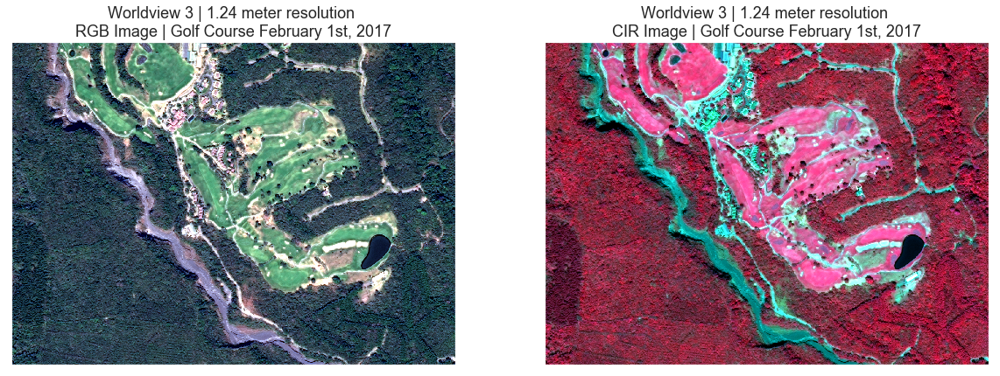

In [34]:
plot_rgb_cir_wv(golf_pre_plot, "3", "Golf Course", "February 1st, 2017")

# Worldview 4 Post Eruption - Golf Course - June 6th, 2018

In [35]:
# Post-eruption 06/06/2018
golf_post_06 = get_bands_wv("golf", "06_06_2018")
golf_post_06_path = "data/group/digital-globe/outputs/golf_post_06"
es.stack_raster_tifs(golf_post_06, golf_post_06_path)
with rio.open(golf_post_06_path) as golf_06:
    golf_post_06, golf_06_affine = mask(golf_06,
                                        [golf_extent], crop=True)

    golf_post_06 = crop_res(golf_post_06, golf_06, 1.001,
                            1.001, 1.001, golf_06_affine)

These post-eruption images show the giant swath of lava seen from the Landsat 8 data earlier. The golf course was directly in the path of flow.

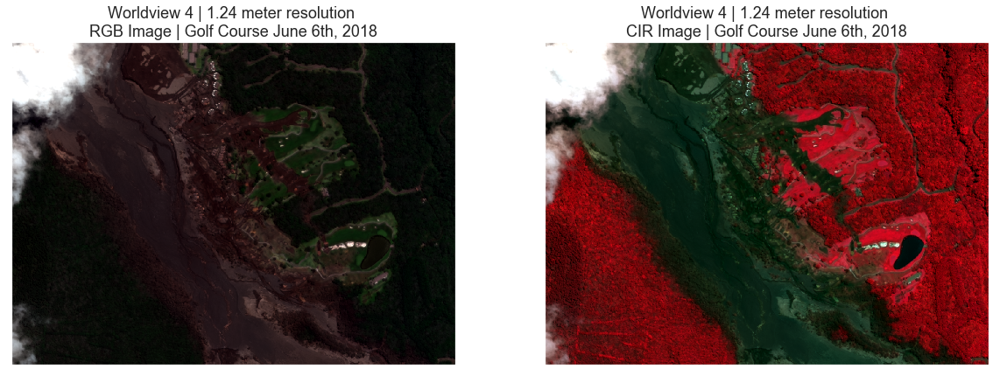

In [36]:
plot_rgb_cir_wv(golf_post_06, "4", "Golf Course", "June 6th, 2018")

# Worldview 3 Post Eruption - Golf Course - June 22nd, 2018

In [37]:
# Post-eruption 06/22/2018
golf_post_22 = get_bands_wv("golf", "06_22_2018")
golf_post_22_path = "data/group/digital-globe/outputs/golf_post_22"
es.stack_raster_tifs(golf_post_22, golf_post_22_path)
with rio.open(golf_post_22_path) as golf_22:
    golf_post_22, golf_22_affine = mask(golf_22,
                                        [golf_extent], crop=True)
    golf_post_22 = crop_res(golf_post_22, golf_22, 1,
                            1.001, 1.001, golf_22_affine)

Another set of images from 3 weeks after the eruption show a clear picture of the size of the lava flow over the golf course.

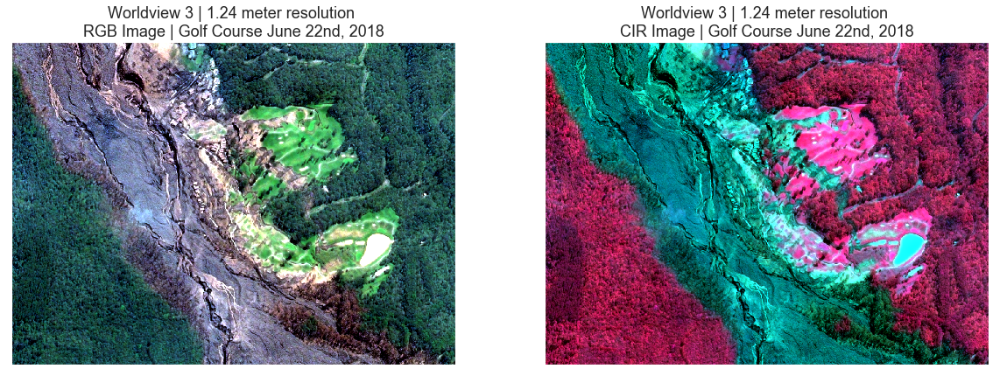

In [38]:
plot_rgb_cir_wv(golf_post_22, "3", "Golf Course", "June 22nd, 2018")

In [39]:
dndvi_golf_06 = calc_dndvi_wv(golf_pre_plot, golf_post_06)
dndvi_golf_22 = calc_dndvi_wv(golf_pre_plot, golf_post_22)

These two dNDVI plots show the overall coverage of lava associated with the eruption. The June 22nd image (right) has darker bands of pink which are most likely due to the image quality of both scenes. The June 22nd data was much brighter than the June 6th data, skewing the plots slightly.

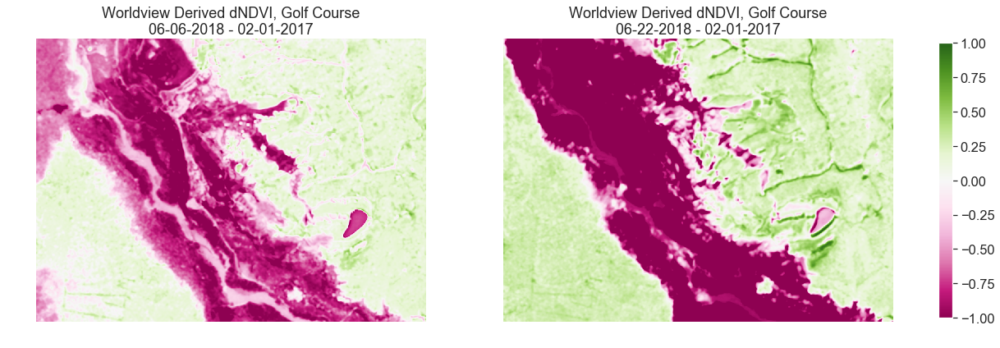

In [40]:
plot_dndvi_wv("Golf Course", dndvi_golf_06, "06-06-2018 - 02-01-2017",
              dndvi_golf_22, "06-22-2018 - 02-01-2017")

The dNDVI histograms also show a good story. Comparing the two histograms, we can see some vegetation regrowth. Looking at the 0.25-0.5 bin goes from roughly 2,500,000 points on June 6th, and then roughly 3,250,000 points on June 22nd.

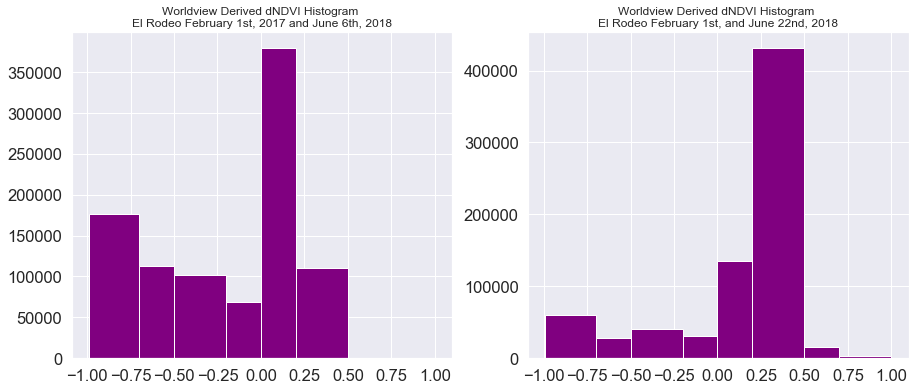

In [41]:
plot_hist_dndvi_wv("El Rodeo", dndvi_golf_06, "February 1st, 2017 and June 6th, 2018",
                   dndvi_golf_22, "February 1st, and June 22nd, 2018")

# Worldview 3 Pre Eruption - El Rodeo - February 5, 2018

In [42]:
# El Rodeo pre-eruption - 02/05/2018
rodeo_pre = get_bands_wv("rodeo", "02_05_2018")
rodeo_pre_path = "data/group/digital-globe/outputs/rodeo_pre"
es.stack_raster_tifs(rodeo_pre, rodeo_pre_path)
with rio.open(rodeo_pre_path) as rodeo_pre:
    rodeo_pre_plot = rodeo_pre.read(masked=True)
    rodeo_extent = mapping(box(*rodeo_pre.bounds))

In the pre-event image, the small village El Rodeo can be seen directly west of the cluster of white rectangular buildings near the top of the image. Pay close attention to this location in the next image.

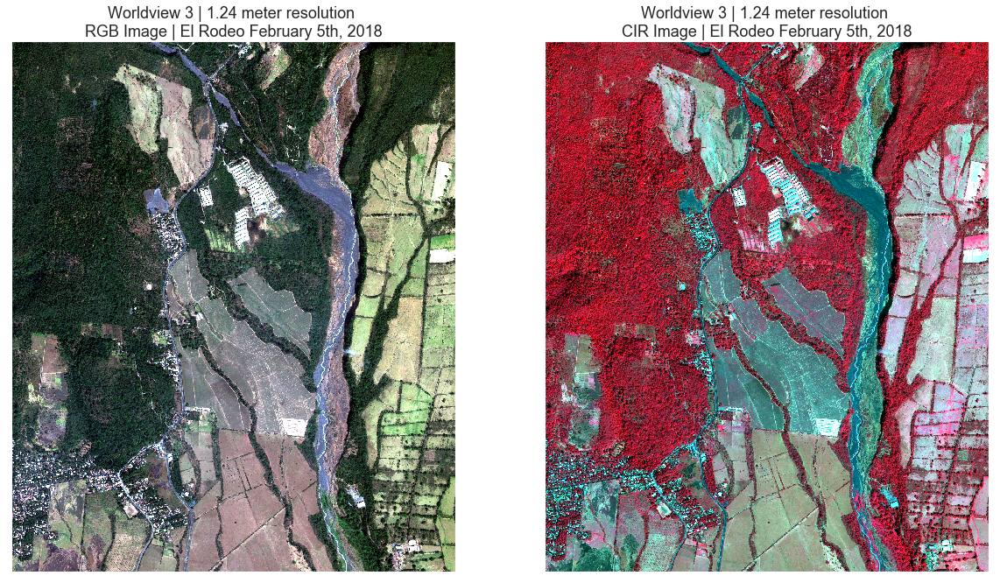

In [43]:
plot_rgb_cir_wv(rodeo_pre_plot, "3", "El Rodeo", "February 5th, 2018")

# Worldview 3 Post Eruption - El Rodeo - June 6, 2018

In [44]:
# El Rodeo post-eruption - 06/06/2018
rodeo_post_06 = get_bands_wv("rodeo", "06_06_2018")
rodeo_post_06_path = "data/group/digital-globe/outputs/rodeo_post_06"
es.stack_raster_tifs(rodeo_post_06, rodeo_post_06_path)
with rio.open(rodeo_post_06_path) as rodeo_06:
    rodeo_post_06, rodeo_06_affine = mask(rodeo_06,
                                          [rodeo_extent], crop=True)

    rodeo_post_06 = crop_res(rodeo_post_06, rodeo_06,
                             1.00018, 1.00025, 1.00018, rodeo_06_affine)

As you can see, almost the entire village was buried from the lava flow. The only buildings that remain are those white rectangular buildings. They luckily escaped destruction as the flow of lava diverged around them.

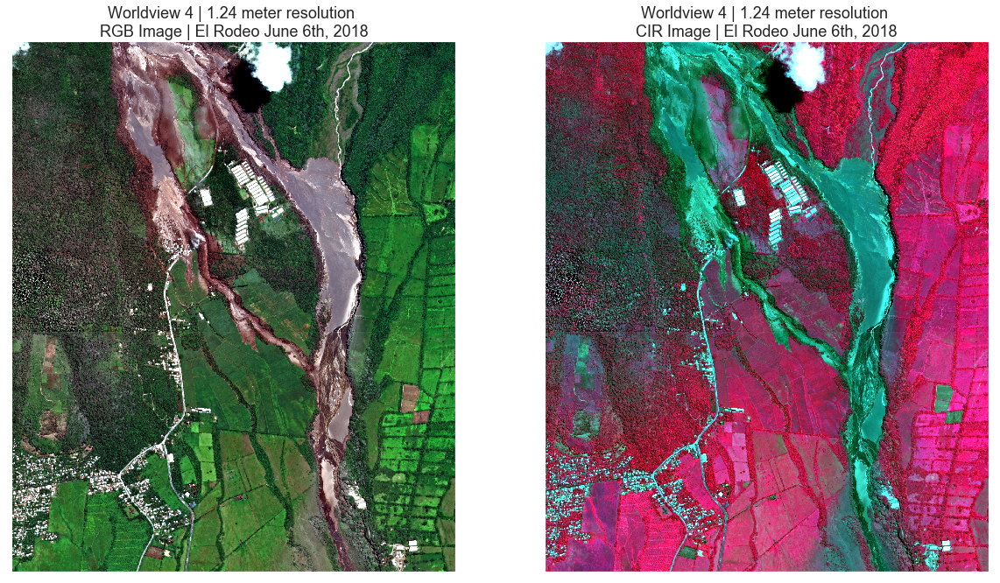

In [45]:
plot_rgb_cir_wv(rodeo_post_06, "4", "El Rodeo", "June 6th, 2018")

# Worldview 3 Post Eruption - El Rodeo - June 23, 2018

In [46]:
# El Rodeo post-eruption - 06/23/2018
rodeo_post_23 = get_bands_wv("rodeo", "06_23_2018")
rodeo_post_23_path = "data/group/digital-globe/outputs/rodeo_post_23"
es.stack_raster_tifs(rodeo_post_23, rodeo_post_23_path)
with rio.open(rodeo_post_23_path) as rodeo_23:
    rodeo_post_23, rodeo_23_affine = mask(rodeo_23,
                                          [rodeo_extent], crop=True)

    rodeo_post_23 = crop_res(rodeo_post_23, rodeo_23,
                             1.0001, 1.0001, 1.0001, rodeo_23_affine)

Another image taken 3 weeks after the eruption shows the same scene as June 6th. The dNDVI of these scenes relative to the pre-eruption date will be compared.

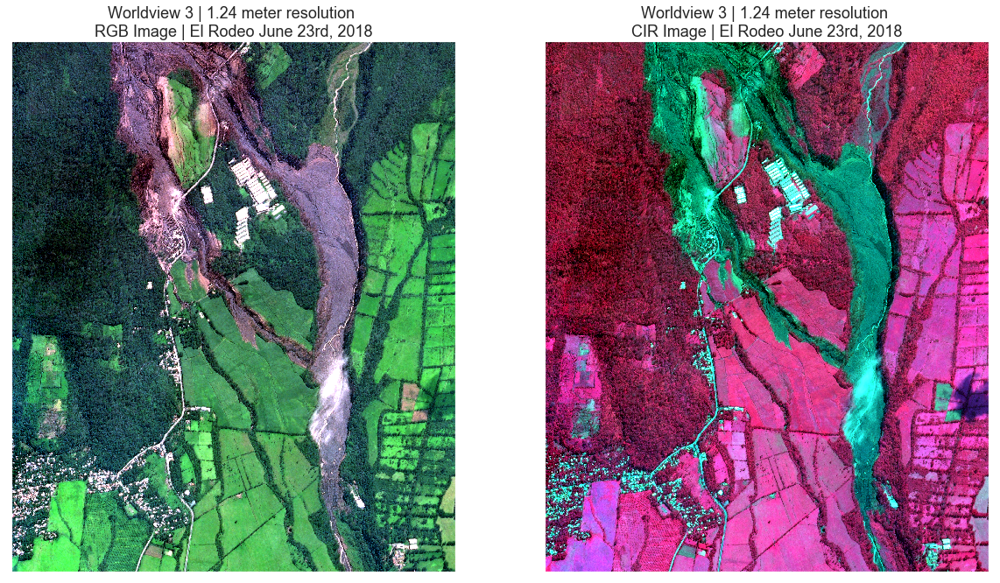

In [47]:
plot_rgb_cir_wv(rodeo_post_23, "3", "El Rodeo", "June 23rd, 2018")

# dNDVI for June 6th, 2018 and June 23rd, 2018 for El Rodeo

As you can see, there seems to be a decrease in vegetation on June 6th (left) on the left side of the image. When comparing the RGB and CIR images above, this looks to be most likely due to ash. In the June 23rd image, this area seems to have rebounded. 

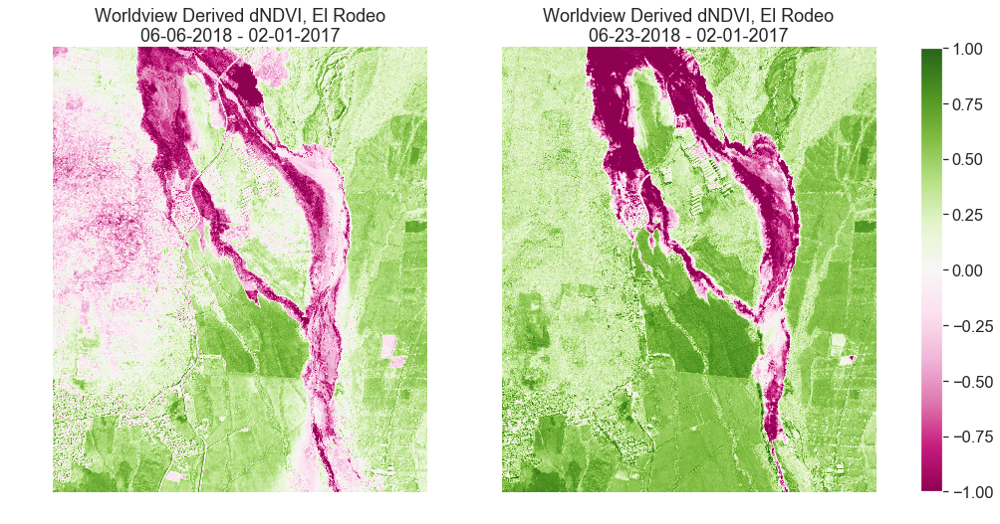

In [48]:
dndvi_rodeo_06 = calc_dndvi_wv(rodeo_pre_plot, rodeo_post_06)
dndvi_rodeo_23 = calc_dndvi_wv(rodeo_pre_plot, rodeo_post_23)
plot_dndvi_wv("El Rodeo", dndvi_rodeo_06, "06-06-2018 - 02-01-2017",
              dndvi_rodeo_23, "06-23-2018 - 02-01-2017")

# Histogram

Once again, the histograms show an increase in values from 0.25-0.5 between June 6th and June 22nd. In this case, a big portion of that increase is most likely due to the removal of ash between these two dates.

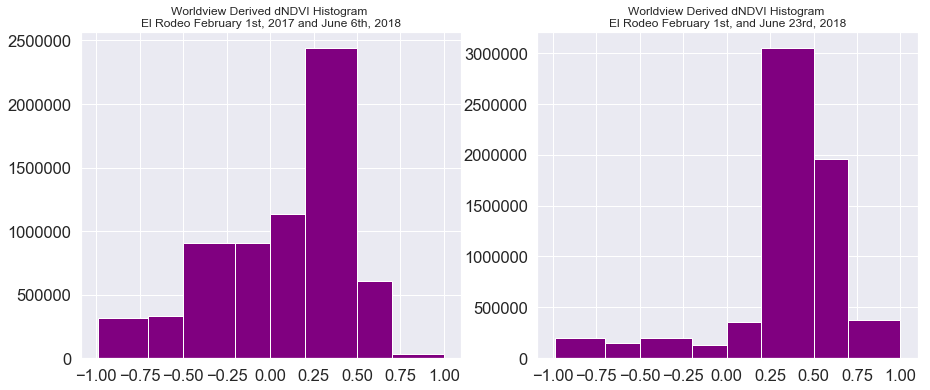

In [49]:
plot_hist_dndvi_wv("El Rodeo", dndvi_rodeo_06, "February 1st, 2017 and June 6th, 2018",
                   dndvi_rodeo_23, "February 1st, and June 23rd, 2018")

Comparing the post-post image (left) and immediately after the eruption (right), we can see a mild NDVI rebound on the edge of the lava flow. The dark green shape in the north of the post-post image is a cloud that was not masked out.

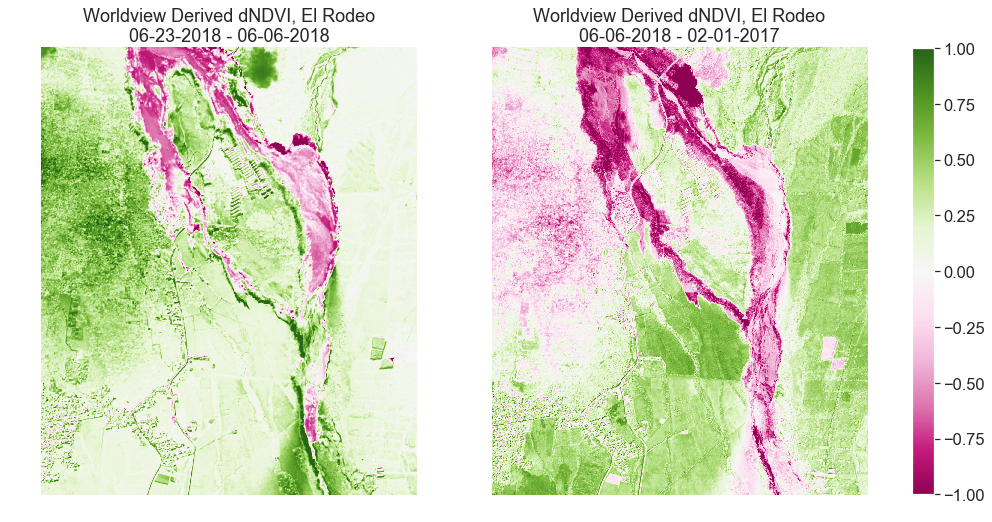

In [50]:
dndvi_rodeo_post = calc_dndvi_wv(rodeo_post_06, rodeo_post_23)
plot_dndvi_wv("El Rodeo", dndvi_rodeo_post, "06-23-2018 - 06-06-2018",
              dndvi_rodeo_06, "06-06-2018 - 02-01-2017")

# Worldview 3 Post Eruption - El Rodeo - June 22, 2018 - Clouds

In [51]:
# El Rodeo post-eruption - 06/22/2018
rodeo_post_22 = get_bands_wv("rodeo", "06_22_2018")
rodeo_post_22_path = "data/group/digital-globe/outputs/rodeo_post_22"
es.stack_raster_tifs(rodeo_post_22, rodeo_post_22_path)
with rio.open(rodeo_post_22_path) as rodeo_22:
    rodeo_post_22, rodeo_22_affine = mask(rodeo_22,
                                          [rodeo_extent], crop=True)

    rodeo_post_22 = crop_res(rodeo_post_22, rodeo_22,
                             1.00018, 1.00025, 1.00018, rodeo_22_affine)

This snapshot is a great example of the difficulty associated with spatial analyses. Due to the nature of satelitte measurements, one of the only scenes we have for El Rodeo has clouds, causing the calculations to not be ideal. We tried to calculate NDVI on this scene but it was skewed due to clouds so it won't be included here.

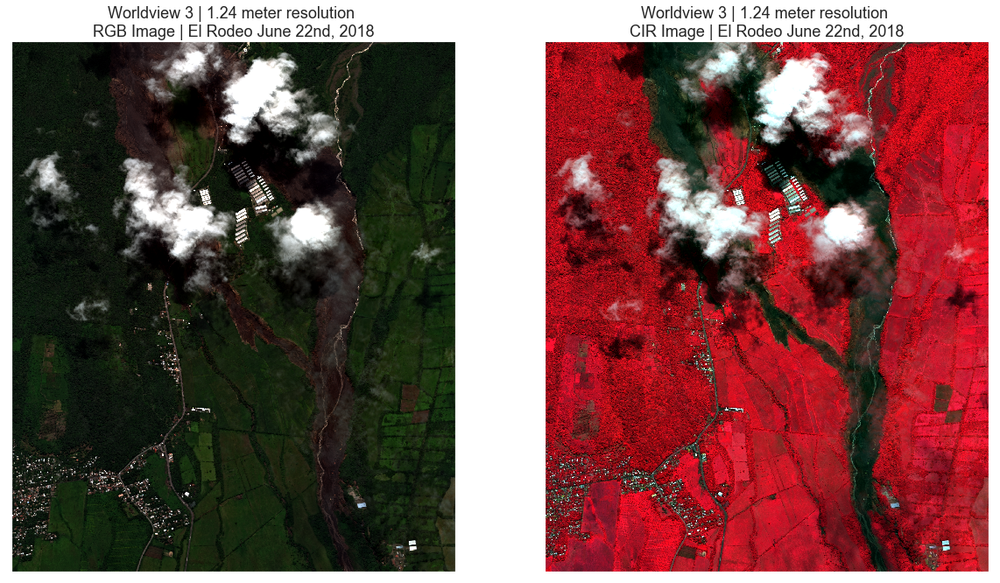

In [52]:
plot_rgb_cir_wv(rodeo_post_22, "3", "El Rodeo", "June 22nd, 2018")

# Difficulties with Digital Globe Data
The spatial resolution of Digital Globe's Worldview 3 and 4 satellites are unmatched. However, there were some issues associated with properly exporting and analyzing the data. When selecting multiple scenes for the same bounding box or area of interest, Digital Globe will import the code to run and create images of each scene. Unfortunately, once imported into the Digital Globe notebook, parsing the dates is not possible because the dates are not imported with the image making it impossible to discern dates. If you are interested in using Digital Globe data in the future, it is highly recommended that you select one scene at a time, import that by itself, and immediately make a comment with the date.

Another issue is that data is only available for specific time periods that Digital Globe has actively chosen to take data from. In the case of this eruption, the stream of data ended after June 23rd so we were unable to get data that was far enough removed from the eruption that we would expect to see substantial vegetation regrowth.

Additionally, the Digital Globe data can be very finicky with their resolutions for each spectral band provided. If you unknowingly export the Digital Globe data to your personal computer, the raster layers will have different resolutions and boundaries creating a mismatch between scenes at different times. NDVI calculations are not possible on these layers because of the size difference. One way to fix this is by forcing each scene to have the same resolution prior to exporting it to your local computer. This can be done by calling the key-word “gsd” during the image creation process on digital globe’s notebooks. That code can be seen below.

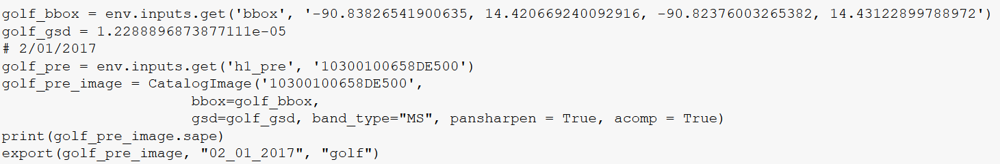

In [53]:
dg_bbox = Image.open("data/group/outputs/figs/dg_bbox_code.png")
dg_bbox

After the resolution for each scene is created and the files are exported, each scene must then be cropped to the extent of a .bounds attribute from the pre-event data. That cropped scene must then go through “Resampling” from the rasterio package “Resample”. If you want to read more about the Resampling package, the documentation can be found here:
https://gbdxtools.readthedocs.io/en/latest/imagery_access.html#catalog-images

With this package and code (example seen below), the user must input values to define how the resolution must be changed (in this case each value was 1.001). Prior to forcing the resolution in the Digital Globe notebook, the resolutions had to be manipulated to get each value to match up. This was no easy task due to how different the resolutions were. In earlier attempts, the relatively easy calculations seen below of multiplying or dividing by 1.001 were instead values like 684/289 or 1386/349. Once the code is set up to properly force resolutions and export the data to your local computer, the calculations become much easier. 

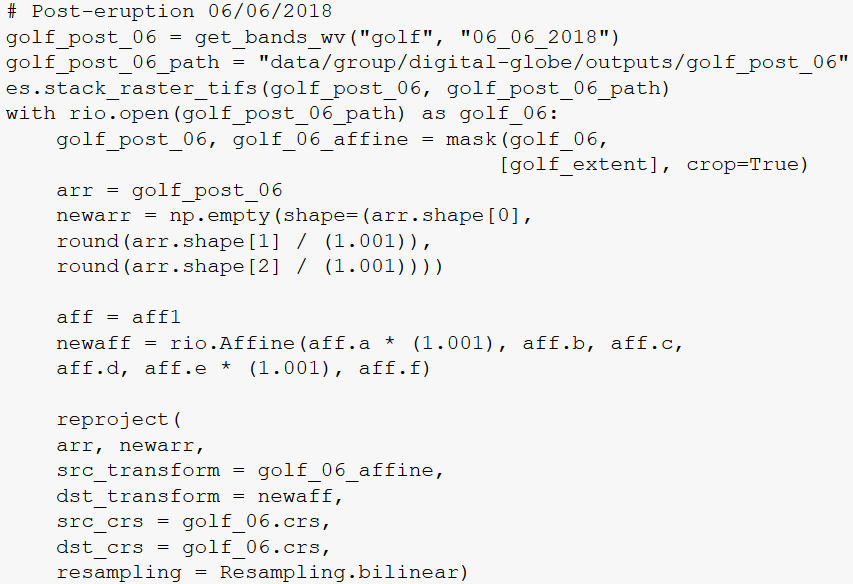

In [54]:
dg_resample = Image.open("data/group/outputs/figs/dg_resample.png")
dg_resample

# Conclusions
As evidenced by the pre-eruption images of El Rodeo, preventative site location studies could have avoided unnecessary infrastructure damage and death. In the El Rodeo RGB images, the rest of the village can be seen to the southwest corner of each image. It is clear that the northern part of El Rodeo (or study location) was directly in the path of flow. If the area was studied more intensely before building, lives could have been saved.

The June 2018 eruption was the largest in 45 years, so while it may not make economic sense to rebuild permanent structures, activities such as farming or tourism may persist if accurate predictions about recurrence intervals, likely path of flows, and quantitative representation of the destruction can be demonstrated. However, with the global population continually growing, this is often not an option for high risk areas. 

Analyzing regrowth after a natural disaster can help discern how quickly communities can rebound after a disaster. In areas that rebound more slowly, more stringent preventative measures should be pursued. In the case of Volcan de Fuego, its location in the tropics helped expedite the regrowth process which can help inform future development decisions. In the future, we hope to continue analyzing the area affected by Volcan de Fuego as more data is collected with Landsat 8 as well as analyze more natural disasters around the world.

# References
Brown, Dr Sarah. “Hawaii Volcano: How Many People Do Volcanoes Kill?” BBC News, BBC, 27 May 2018, www.bbc.com/news/world-us-canada-44212666.

COSPEC. “Volcano World.” Deadliest Eruption | Volcano World | Oregon State University, Oregon State University, volcano.oregonstate.edu/collecting-gas-samples.

Dempsey, Caitlin. “Using Satellite Imagery to Track Volcanic Ash Clouds.” GIS Lounge, GIS Lounge, 1 Dec. 2018, www.gislounge.com/using-satellite-imagery-to-track-volcanic-ash-clouds/.

Elias, Tamar, et al. Comparison of COSPEC and Two Miniature Ultraviolet Spectrometer Systems for SO2 Measurements Using Scattered Sunlight. Springer, 4 Jan. 2006, link.springer.com/article/10.1007%2Fs00445-005-0026-5.

Galle, Bo, et al. A Miniaturised Ultraviolet Spectrometer for Remote Sensing of SO2 Fluxes: a New Tool for Volcano Surveillance. Elsevier, 3 June 2002, www.sciencedirect.com/science/article/abs/pii/S0377027302003566.

Keneally, Meghan. “Drone Footage Gives Terrifying Glimpse of Hawaiian Volcano Damage.” ABC News, ABC News Network, 7 May 2018, abcnews.go.com/US/drone-footage-terrifying-glimpse-hawaiian-volcano-damage/story?id=54987152.

Land | Natural Earth. www.naturalearthdata.com/downloads/110m-physical-vectors/110m-land/.

Merucci, Luca, et al. “Remote Sensing.” MDPI, Multidisciplinary Digital Publishing Institute, 22 Feb. 2016, www.mdpi.com/journal/remotesensing/special_issues/volcano.

National Geographic Society. “Ring of Fire.” National Geographic Society, 9 Oct. 2012, www.nationalgeographic.org/encyclopedia/ring-fire/.

“Reliefweb: Guatemala: Volcanic Eruption Situation Report No. 5 (as of 29 June 2018) - Guatemala.” UN Office for the Coordination of Humanitarian Affairs, 29 June 2018, reliefweb.int/report/guatemala/guatemala-volcanic-eruption-situation-report-no-5-29-june-2018.

“U.S. Volcanoes and Current Activity Alerts.” USGS Volcano Hazards Program, USGS, volcanoes.usgs.gov/index.html.

“Worldvision: 2018 Guatemala Volcano Eruption: Facts, FAQs, and How to Help.” 9 Oct. 2018, www.worldvision.org/disaster-relief-news-stories/guatemala-volcano-eruption-facts#fast-facts.